# Control Net

/home/jomari/repositories/expt_diffusion/diff-expt/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]/home/jomari/repositories/expt_diffusion/diff-expt/lib/python3.12/site-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
100%|██████████| 40/40 [00:23<00:00,  1.69it/s]


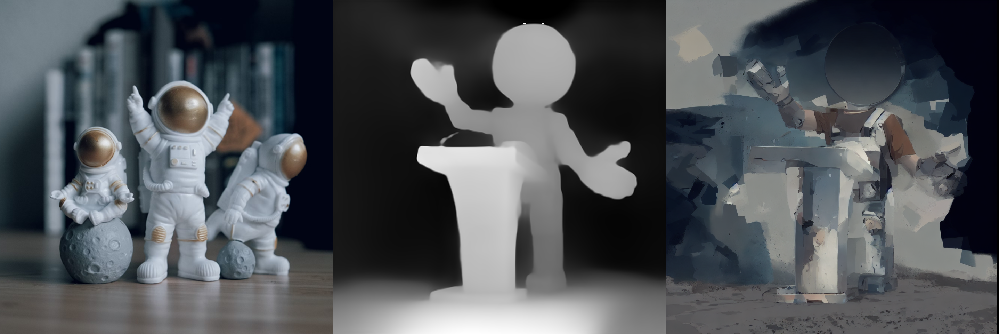

In [1]:
from diffusers.utils import load_image, make_image_grid
from diffusers import ControlNetModel, AutoPipelineForImage2Image
import torch

# prepare image
url = "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/img2img-init.png"
init_image = load_image(url)
init_image = init_image.resize((958, 960)) # resize to depth image dimensions
depth_image = load_image("https://huggingface.co/lllyasviel/control_v11f1p_sd15_depth/resolve/main/images/control.png")
make_image_grid([init_image, depth_image], rows=1, cols=2)


controlnet = ControlNetModel.from_pretrained("lllyasviel/control_v11f1p_sd15_depth", torch_dtype=torch.float16, variant="fp16", use_safetensors=True)
pipeline = AutoPipelineForImage2Image.from_pretrained(
    "runwayml/stable-diffusion-v1-5", controlnet=controlnet, torch_dtype=torch.float16, variant="fp16", use_safetensors=True
)
pipeline.enable_model_cpu_offload()

prompt = "Rough road in a hot dessert, cold color palette, muted colors, detailed, 8k"
image_control_net = pipeline(prompt, image=init_image, control_image=depth_image).images[0]
make_image_grid([init_image, depth_image, image_control_net], rows=1, cols=3)

## Load font images

In [9]:
import os
import numpy as np
from PIL import Image

words = []
for img in os.listdir('words'):
    words.append(os.path.join('words', img))

textures = []
for img in os.listdir('textures'):
    textures.append(os.path.join('textures', img))

## Invert the font image

In [15]:
from PIL import ImageOps

inverted_imgs = []
for word in words:
    ii = Image.open(word)
    inverted_imgs.append(ImageOps.invert(ii))

### This will be your depth image

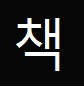

(86, 84, 3)


In [40]:
inverted_imgs[0].show()
print(np.shape(inverted_imgs[0]))
original_font_shape = np.shape(inverted_imgs[0])

## Select textures

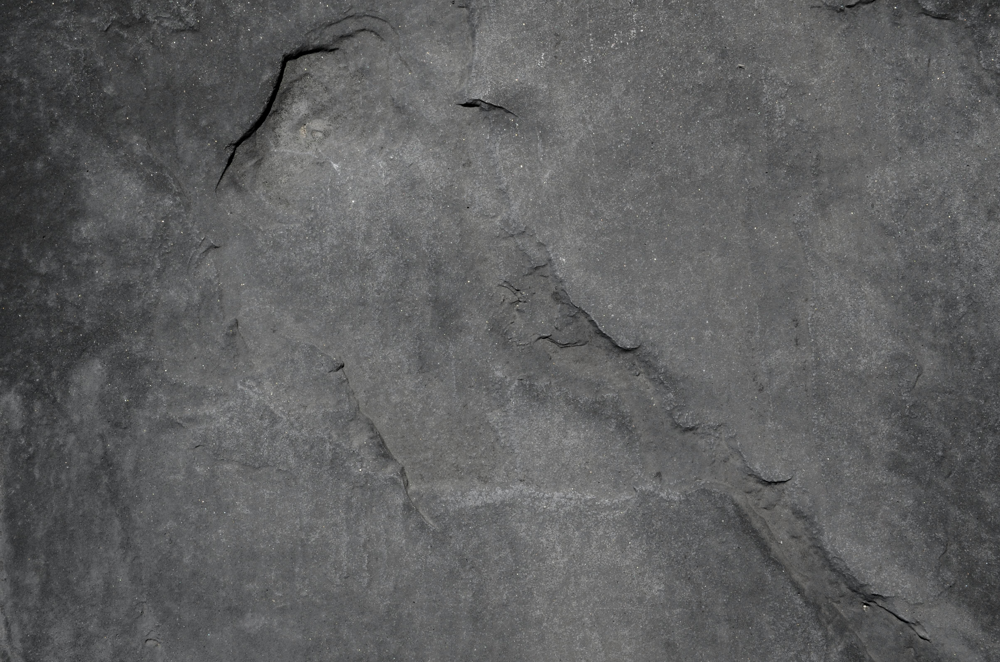

(3187, 4811, 3)


In [27]:
texture_img = Image.open(textures[0])
texture_img.show()
print(np.shape(texture_img))

### Generate a controlled image

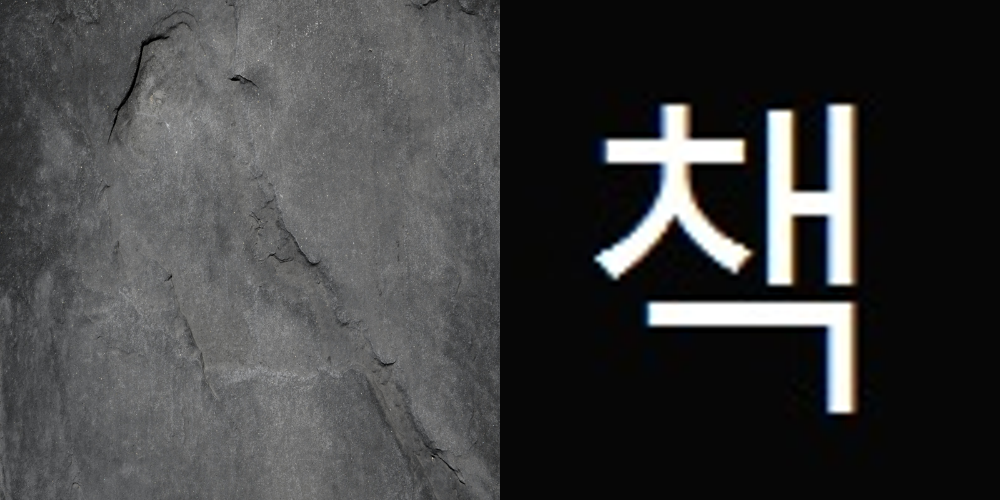

In [29]:
img_size = (800,800)

# prepare image
init_image = load_image(texture_img)
init_image = init_image.resize(img_size) # resize to depth image dimensions
depth_image = load_image(inverted_imgs[0])
depth_image = depth_image.resize(img_size)
make_image_grid([init_image, depth_image], rows=1, cols=2)


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]/home/jomari/repositories/expt_diffusion/diff-expt/lib/python3.12/site-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
100%|██████████| 40/40 [00:21<00:00,  1.86it/s]


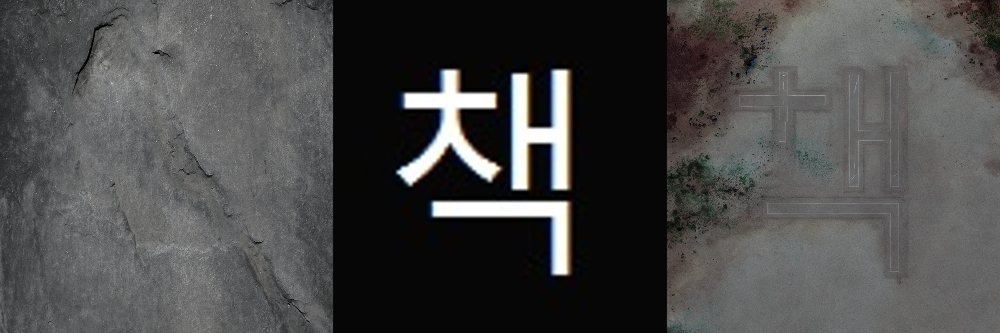

In [30]:
controlnet = ControlNetModel.from_pretrained("lllyasviel/control_v11f1p_sd15_depth", torch_dtype=torch.float16, variant="fp16", use_safetensors=True)
pipeline = AutoPipelineForImage2Image.from_pretrained(
    "runwayml/stable-diffusion-v1-5", controlnet=controlnet, torch_dtype=torch.float16, variant="fp16", use_safetensors=True
)
pipeline.enable_model_cpu_offload()

prompt = "Rough road in a hot dessert, cold color palette, muted colors, detailed, 8k"
image_control_net = pipeline(prompt, image=init_image, control_image=depth_image).images[0]
make_image_grid([init_image, depth_image, image_control_net], rows=1, cols=3)

### Try on different prompts

100%|██████████| 40/40 [00:15<00:00,  2.52it/s]


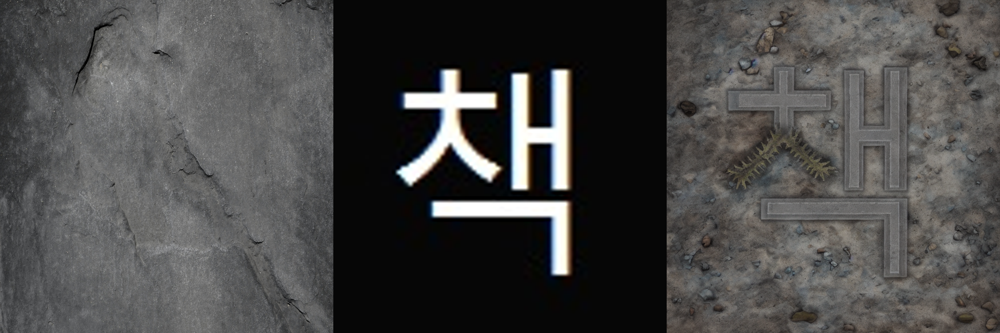

100%|██████████| 40/40 [00:16<00:00,  2.50it/s]


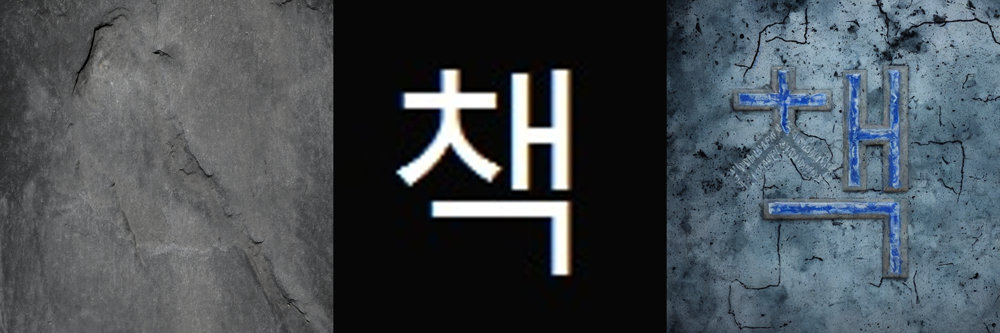

In [32]:
prompts = [
    "Rough road in a hot dessert, cold color palette, muted colors, detailed, 8k",
    "Wall writing with drain stains, creepy dark place, blue pallette, earth colors, detailed, 8k"
]

for prompt in prompts:
    image_control_net = pipeline(prompt, image=init_image, control_image=depth_image).images[0]
    make_image_grid([init_image, depth_image, image_control_net], rows=1, cols=3).show()

## Try different textures

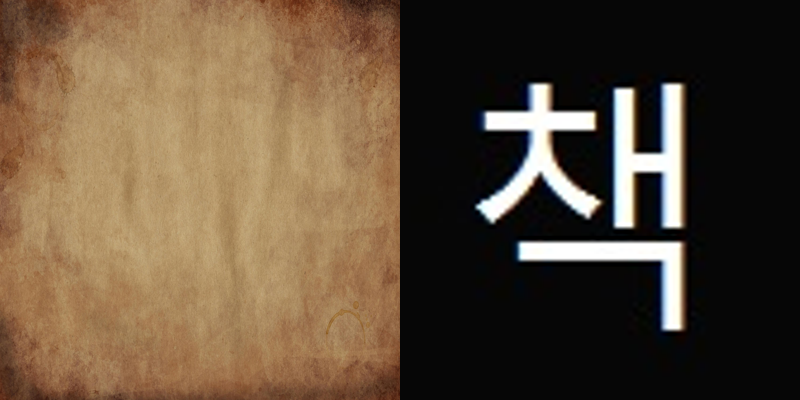

100%|██████████| 40/40 [00:06<00:00,  6.39it/s]


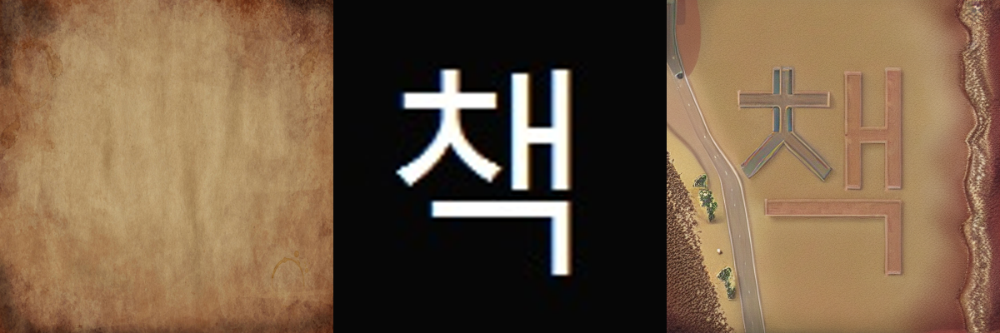

100%|██████████| 40/40 [00:05<00:00,  7.84it/s]


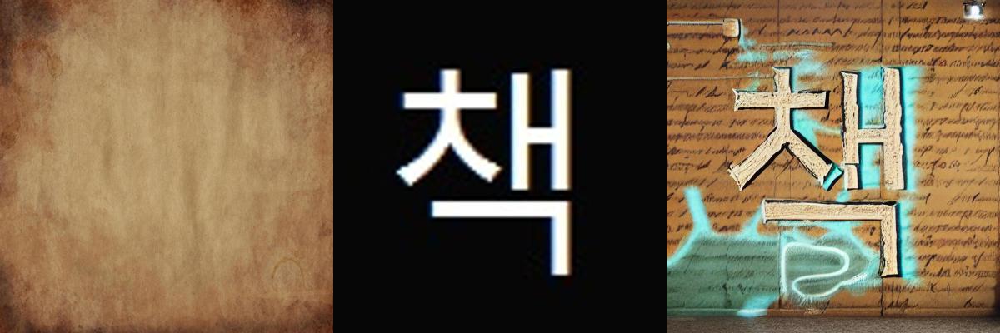

In [72]:
texture_img = load_image(textures[2])

img_size = (400,400)

# prepare image
init_image = load_image(texture_img)
init_image = init_image.resize(img_size) # resize to depth image dimensions
depth_image = load_image(inverted_imgs[0])
depth_image = depth_image.resize(img_size)
make_image_grid([init_image, depth_image], rows=1, cols=2).show()

# If pipeline is already loaded
prompts = [
    "Rough road in a hot dessert, cold color palette, muted colors, detailed, 8k",
    "Wall writing with drain stains, creepy dark place, blue pallette, earth colors, detailed, 8k"
]

cn_imgs = []
for prompt in prompts:
    image_control_net = pipeline(prompt, image=init_image, control_image=depth_image).images[0]
    cn_imgs.append(image_control_net)
    make_image_grid([init_image, depth_image, image_control_net], rows=1, cols=3).show()

### Extract font back
Use the depth image field as mask

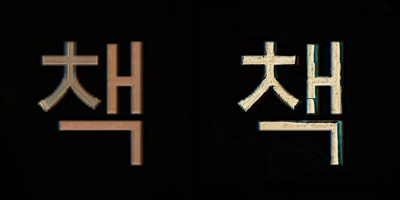

In [73]:
from PIL import ImageChops

styled_fonts = []
for cn_img in cn_imgs:
    styled_fonts.append(ImageChops.multiply(cn_img, depth_image))

make_image_grid(styled_fonts, rows=1, cols=2, resize=200)

### Soften the depth image

100%|██████████| 40/40 [00:05<00:00,  7.98it/s]


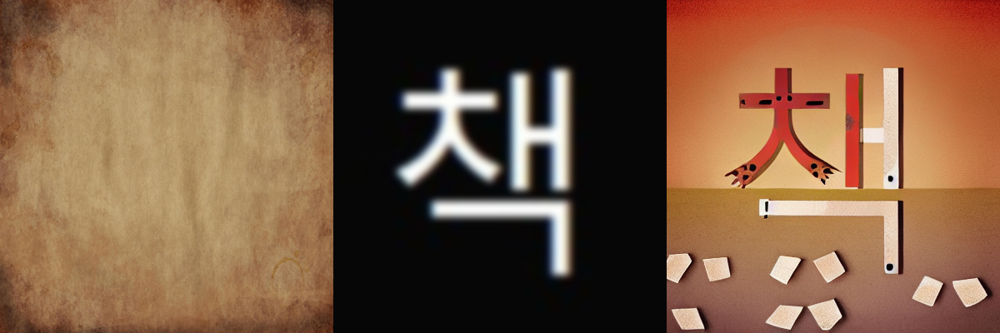

100%|██████████| 40/40 [00:05<00:00,  7.94it/s]


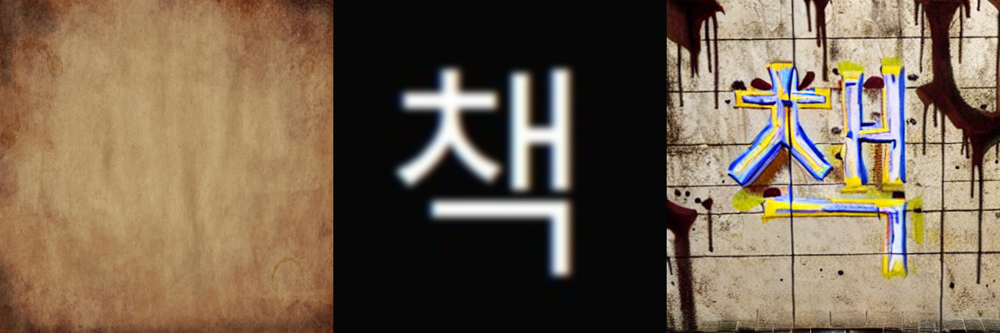

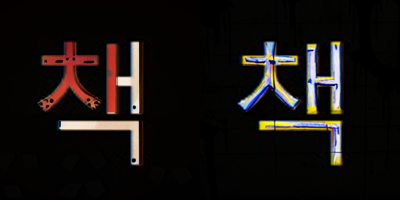

In [76]:
from PIL import ImageFilter

blurred_depth_image = depth_image.filter(ImageFilter.GaussianBlur(4))

cn_imgs = []
for prompt in prompts:
    image_control_net = pipeline(prompt, image=init_image, control_image=depth_image).images[0]
    cn_imgs.append(image_control_net)
    make_image_grid([init_image, blurred_depth_image, image_control_net], rows=1, cols=3).show()

styled_fonts = []
for cn_img in cn_imgs:
    styled_fonts.append(ImageChops.multiply(cn_img, depth_image))

make_image_grid(styled_fonts, rows=1, cols=2, resize=200).show()

#### Summary
- Downloaded different textures
- Used `words` as pictures for depth
- Resize image to give the model more pixels to work with
- Implemented ControlNet
- Mask back the images
- Soften the depth image to design different images

#### Next tasks
- transform original text and apply texture and prompt
- Apply process to more words
- Can try on low-resource font images